# 1. Import modules and load MERFISH data 

In [1]:
import numpy as np
import pandas as pd
import seaborn as sns
import anndata
import scanpy as sc
import os

import matplotlib.pyplot as plt

sc.settings.n_jobs = 24
sc.settings.set_figure_params(dpi=180, dpi_save=300, frameon=False, figsize=(4, 4), fontsize=8, facecolor='white')

# 2. Load MERLin analysis results

In [2]:
merlin_output_folder = r'I:\MERFISH_Analysis\20220203-P_brain_M1_nonclear'
# generate post-analysis folders
postanalysis_folder = merlin_output_folder+'_PostAnalysis'
if not os.path.exists(postanalysis_folder):
    print(f"Create folder: {postanalysis_folder}")
    os.makedirs(postanalysis_folder)
else:
    print(f"Use folder: {postanalysis_folder}")

Create folder: I:\MERFISH_Analysis\20220203-P_brain_M1_nonclear_PostAnalysis


In [3]:
# Load Cell information
cell_meta_data_file = os.path.join(merlin_output_folder, 'ExportCellMetadata', 'feature_metadata.csv')
cell_meta_data = pd.read_csv(cell_meta_data_file)
cell_meta_data

,Unnamed: 0,fov,volume,center_x,center_y,min_x,max_x,min_y,max_y
0,101404625324144731714156423873421894173,0,21.977193,-2902.127898,1434.245980,-2904.298698,-2899.957098,1432.021179,1436.470780
1,104282370230867140799582773277417883104,0,461.784083,-3050.357902,1483.979981,-3054.526702,-3046.189102,1479.649181,1488.310781
2,105416025296006674922851336463918655357,0,698.778146,-3031.349902,1337.909977,-3036.382702,-3026.317101,1331.365177,1344.454777
3,105789079412676084148146849227937390456,0,6.467222,-2939.117899,1334.777977,-2940.262699,-2937.973099,1333.417177,1336.138777
4,106320897321687815908943825141808330010,0,2.484899,-2981.183900,1365.341978,-2981.842700,-2980.525100,1363.873178,1366.810778
...,...,...,...,...,...,...,...,...,...
29780,94456039263170620850522517184611816971,168,474.777779,5180.357807,-402.755984,5176.729007,5183.986607,-407.842784,-397.669184
29781,9569117181874016324177630204775313501,168,13.356680,5080.403805,-474.359986,5078.989005,5081.818605,-476.314786,-472.405185
29782,97177481864118490236514786233118254449,168,1097.213175,5209.139808,-489.965986,5201.677008,5216.602608,-497.590786,-482.341186
29783,97690330316604237520018912976775712903,168,940.827387,5160.647807,-551.795988,5154.157007,5167.138607,-558.934788,-544.657187


In [4]:
# Load decoded counts information
counts_file_mer = os.path.join(merlin_output_folder, 'ExportPartitionedBarcodes', 'barcodes_per_feature.csv')
df = pd.read_csv(counts_file_mer).rename(columns={'Unnamed: 0':'index'}).set_index('index')
#blanks = [f'Blank-{i}' for i in range(1, 11)]
for _c in df.columns:
    if 'Blank-' in _c:
        df = df.drop(columns=_c)
adata = anndata.AnnData(df)
adata.obs = adata.obs.merge(cell_meta_data, left_index=True, right_on='Unnamed: 0').set_index('Unnamed: 0')

In [5]:
df

,1700022I11Rik,1810046K07Rik,5031425F14Rik,5730522E02Rik,Acta2,Adam2,Adamts2,Adamts4,Adra1b,Alk,...,Unc13c,Unc5b,Unc5d,Ust,Vipr2,Vtn,Vwc2,Wipf3,Wnt7b,Zfp804b
index,,,,,,,,,,,,,,,,,,,,,
101404625324144731714156423873421894173,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
104282370230867140799582773277417883104,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
105416025296006674922851336463918655357,0.0,0.0,0.0,0.0,6.0,0.0,0.0,0.0,0.0,0.0,...,6.0,0.0,2.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
105789079412676084148146849227937390456,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
106320897321687815908943825141808330010,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
94456039263170620850522517184611816971,0.0,0.0,0.0,0.0,1.0,1.0,0.0,0.0,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
9569117181874016324177630204775313501,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
97177481864118490236514786233118254449,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,4.0,1.0,0.0,0.0,0.0,26.0,0.0,0.0,0.0,0.0


# 3. Seperate check on some marker genes.

In [6]:
# load gene names
sel_gene_df = pd.read_excel(r'\\10.245.74.212\Chromatin_NAS_2\Chromatin_Libraries\CTP-12_mop_markers\smFISH_cell_class\MOP_marker_gene_readout.xlsx',
                          )

In [8]:
gene_2_count = {}
for _gene in sel_gene_df['Target gene']:
    if _gene in df.columns:
        _counts = df[_gene]
        gene_2_count[_gene] = np.array(_counts)
    else:
        gene_2_count[_gene] = []

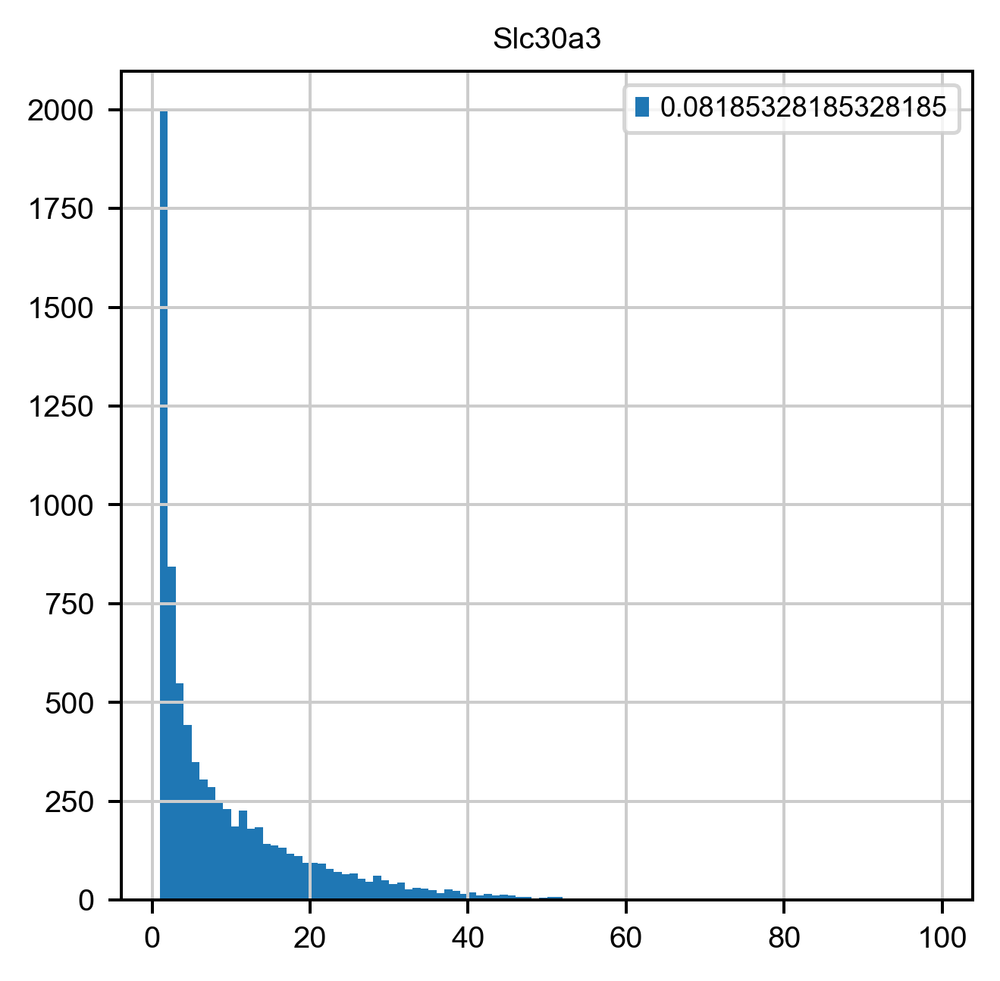

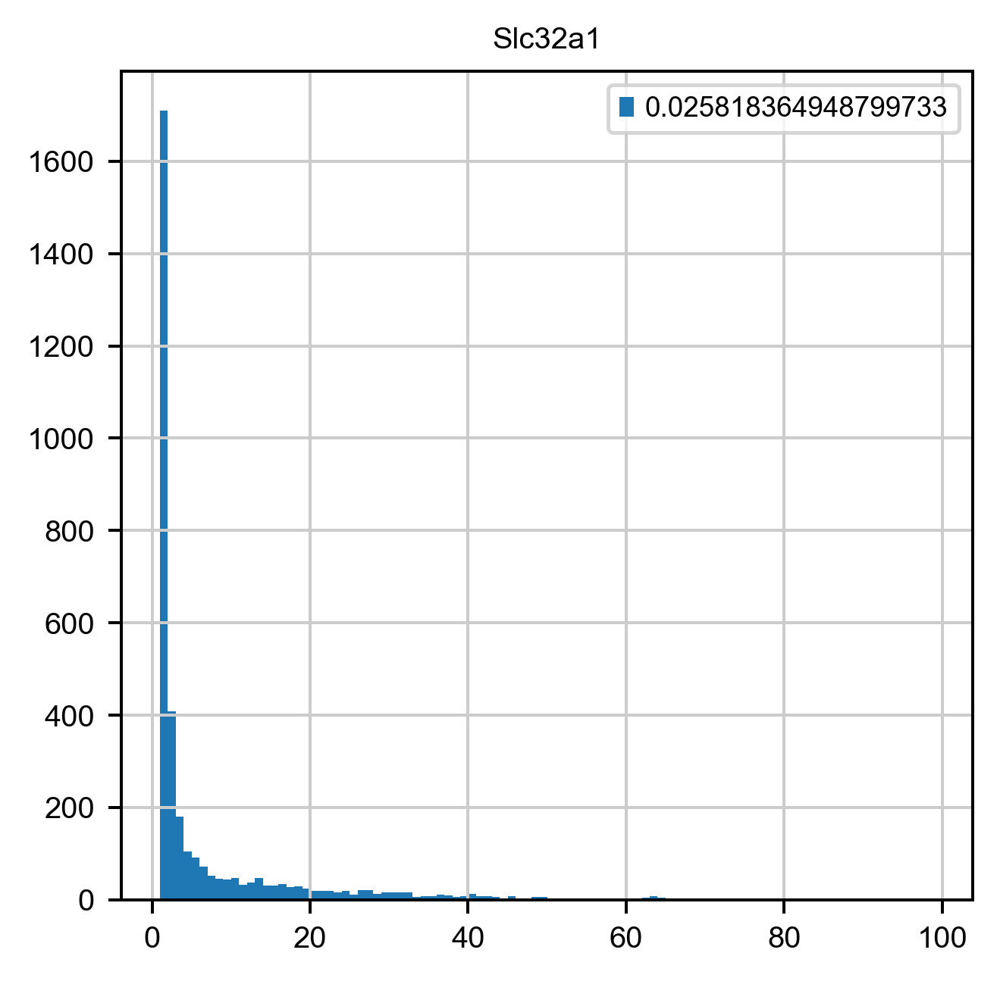

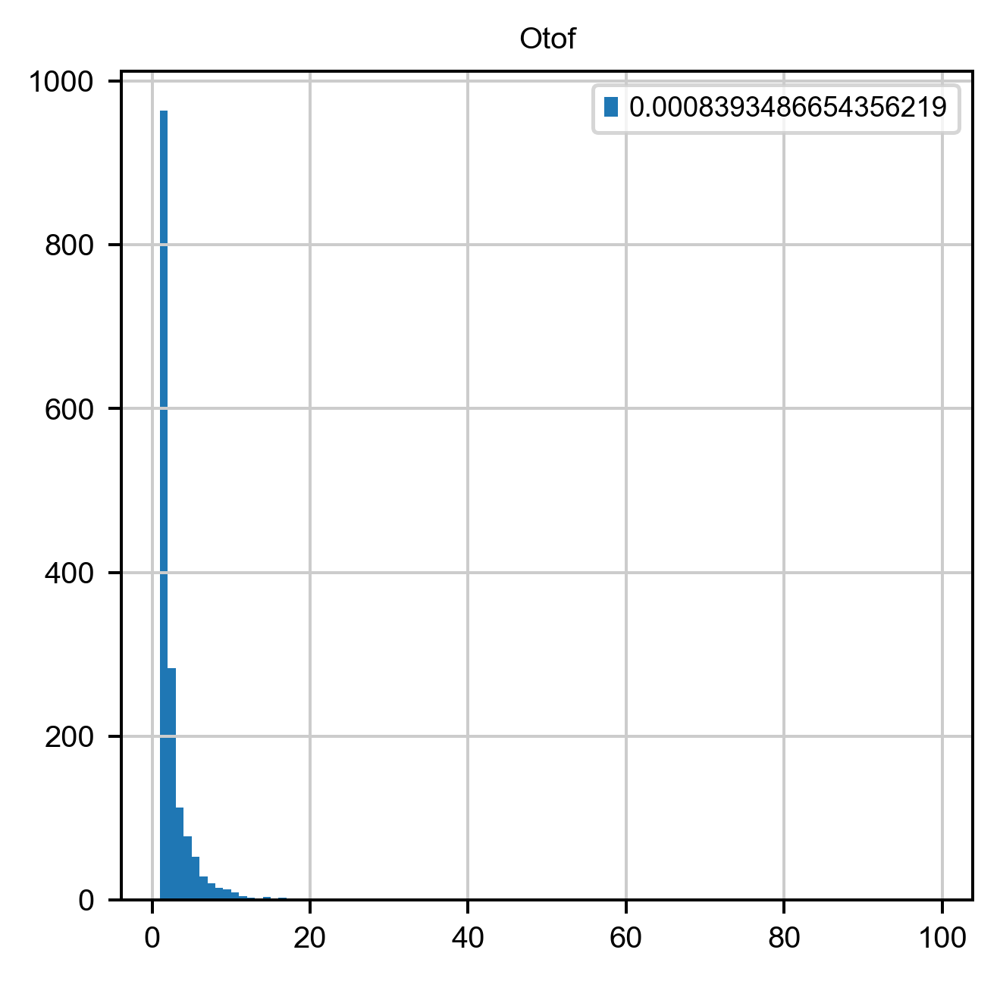

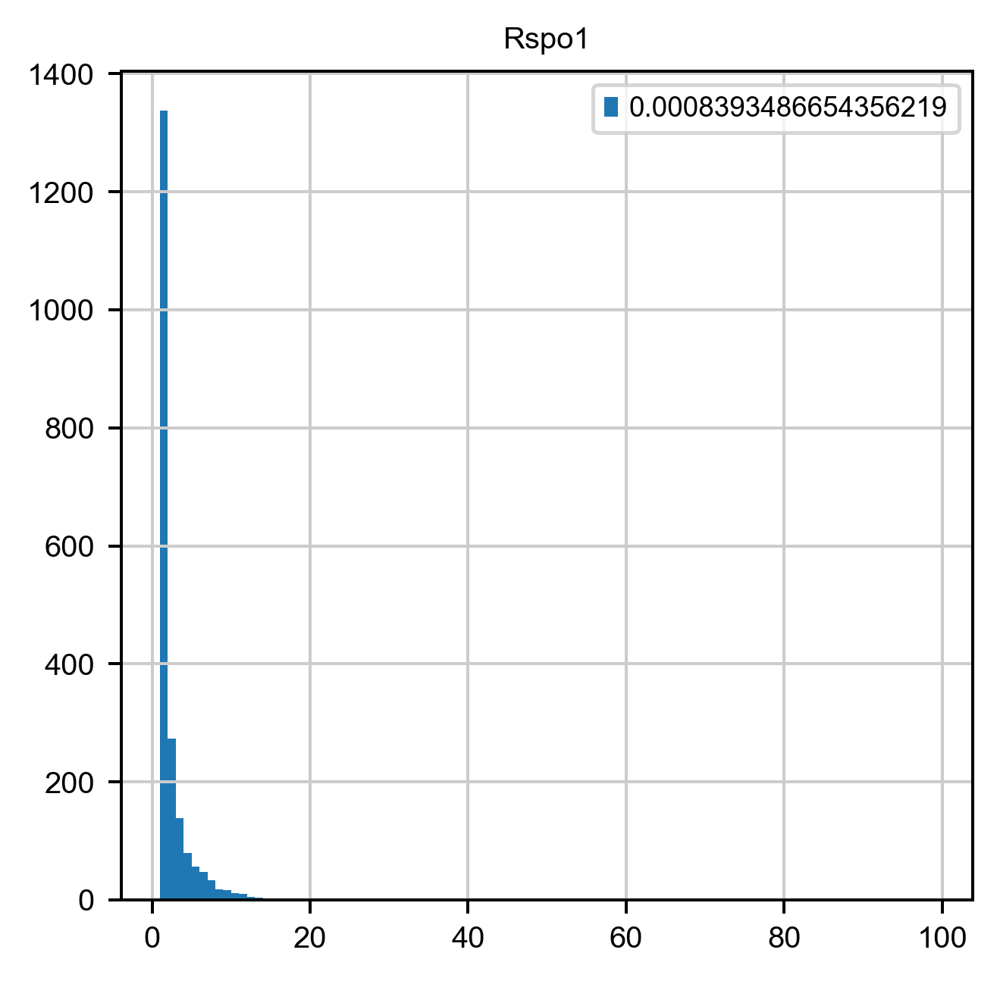

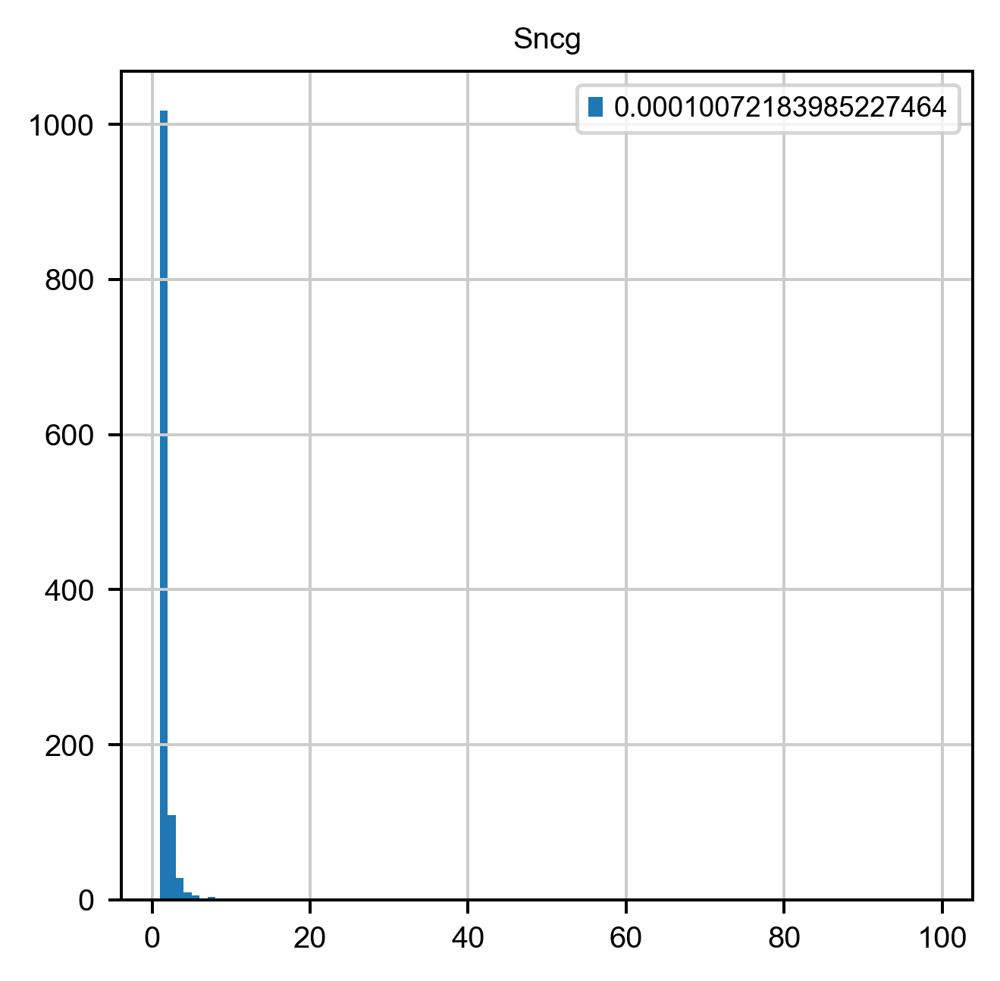

...

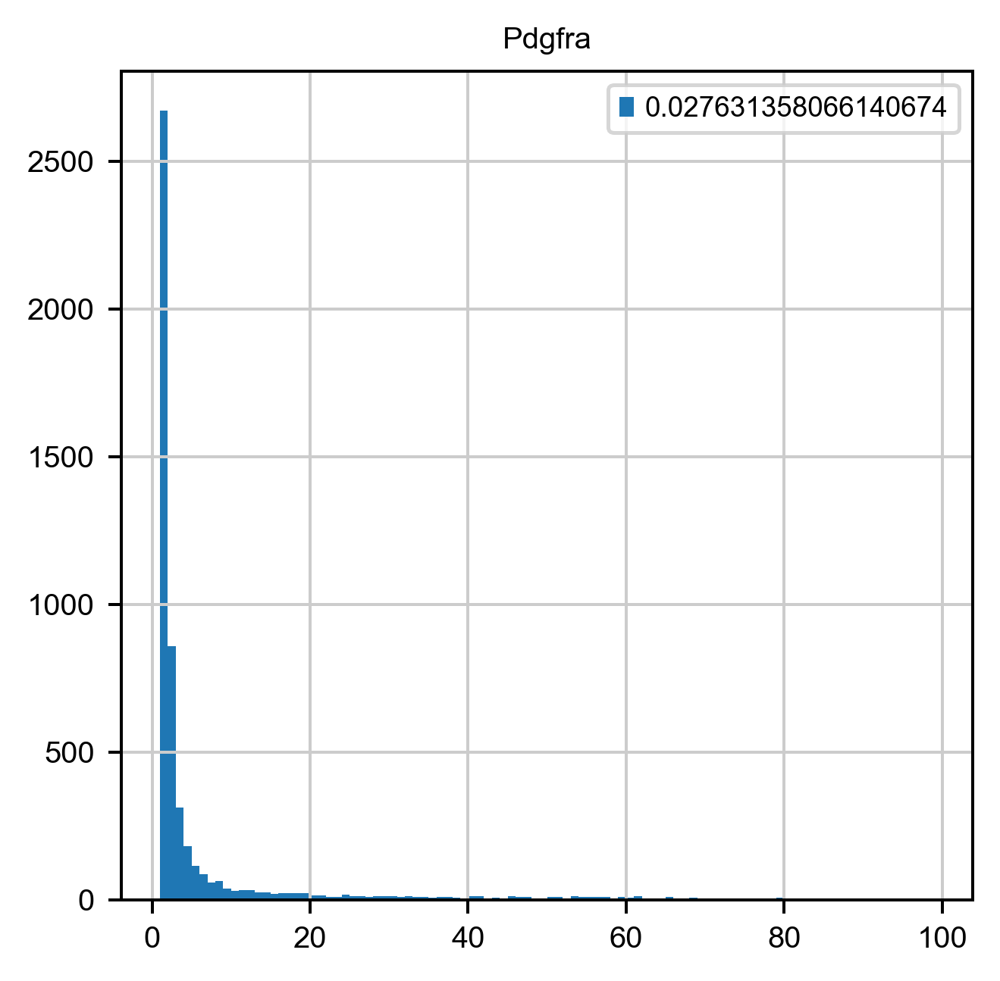

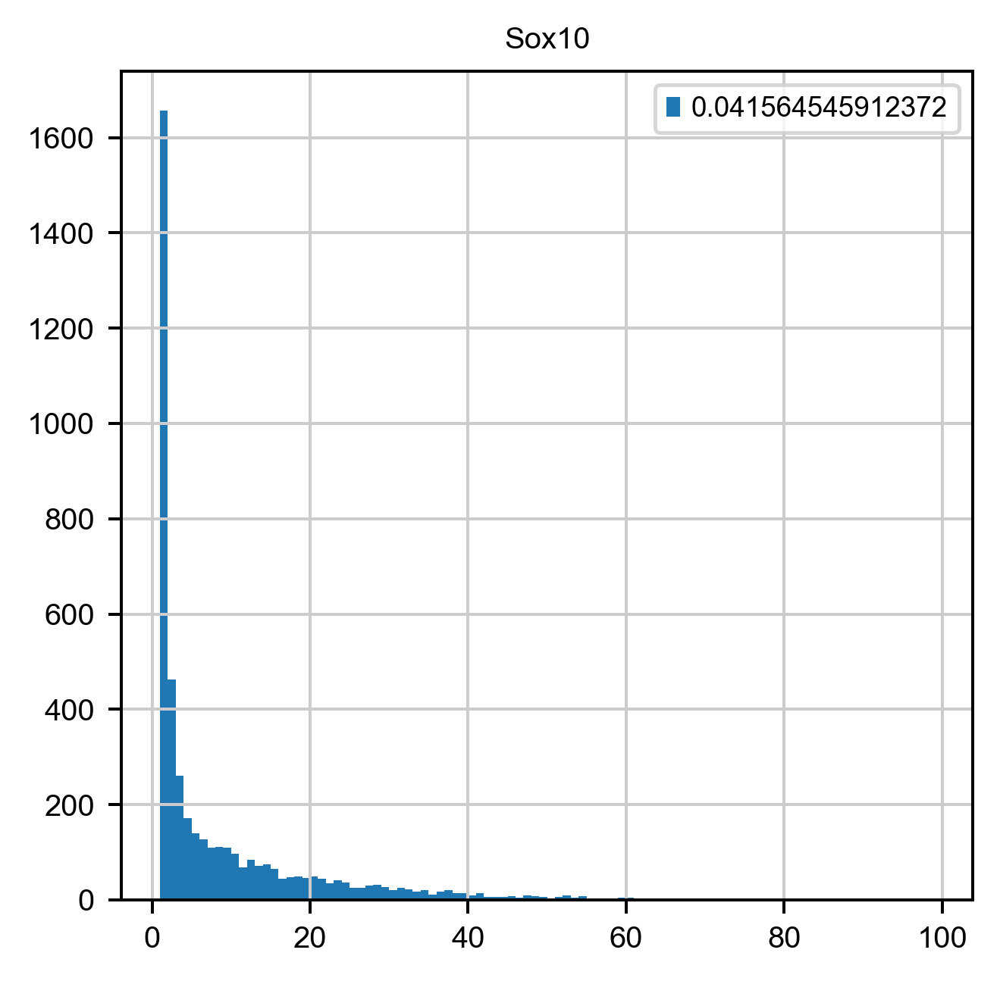

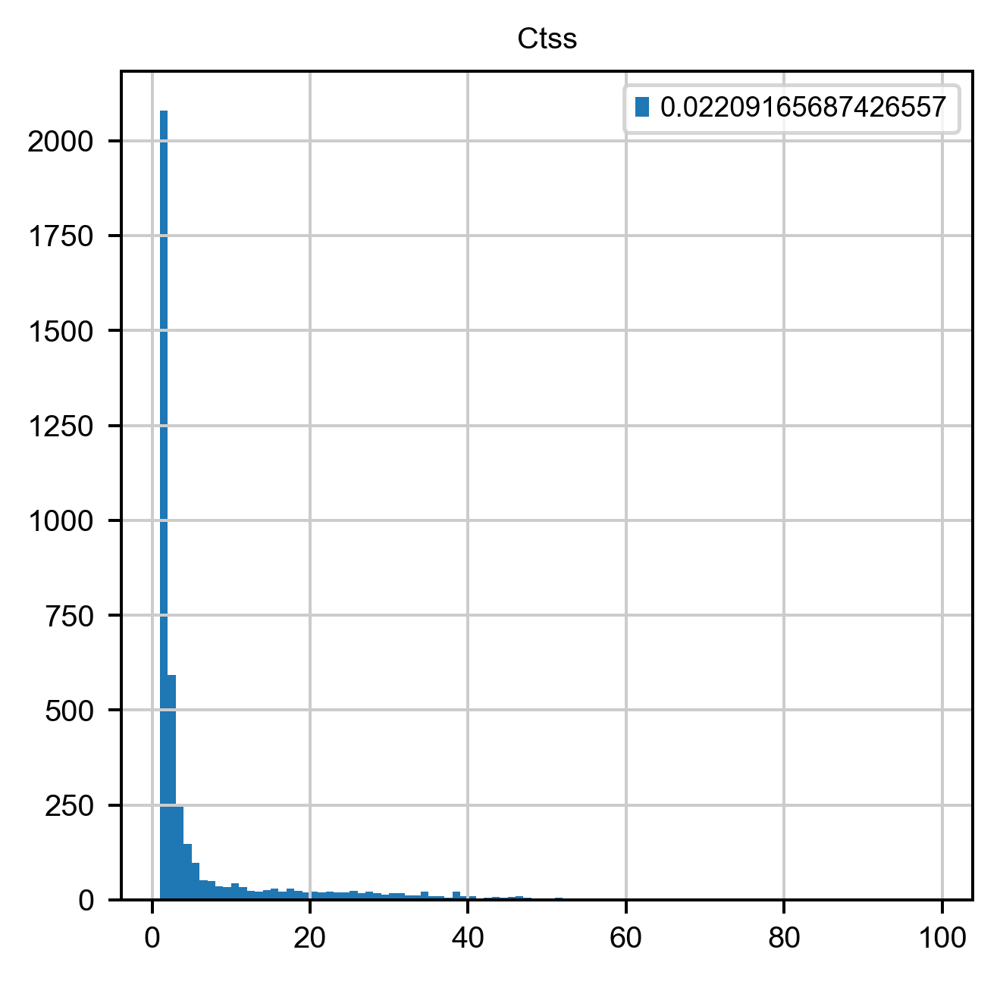

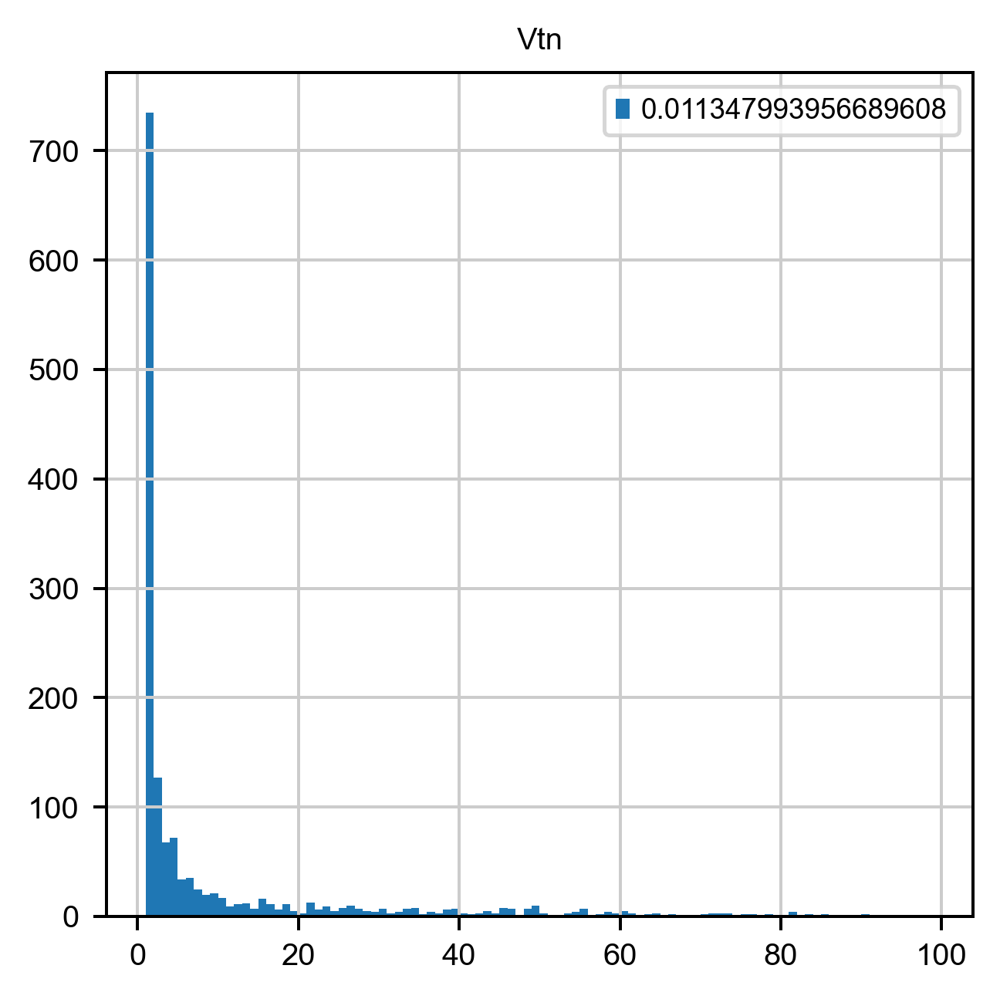

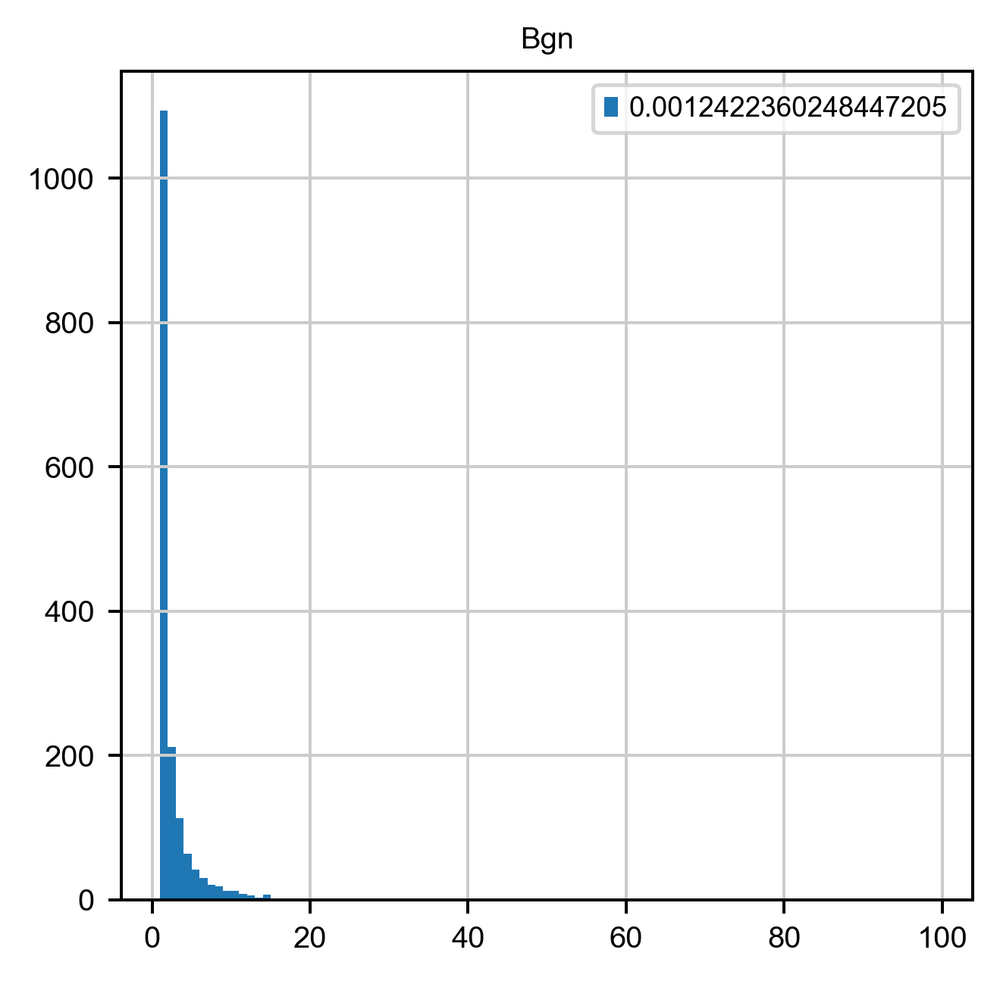

In [9]:
for _gene, _counts in gene_2_count.items():
    if len(_counts) > 0:
        plt.figure()
        plt.hist(_counts, bins=np.arange(1,100), label=f"{np.mean(_counts>10)}")
        plt.legend()
        plt.title(_gene)
        plt.show()

# 4. Preprocess and filter the MERFISH data 

In [10]:
gene_to_percent = pd.DataFrame()
gene_to_percent['gene'] = list(gene_2_count.keys())

In [14]:
percent_counts = []
count_th = 5
for _gene, _counts in gene_2_count.items():
    if len(_counts) > 0:
        percent_counts.append(np.mean(_counts>count_th))
    else:
        percent_counts.append(np.nan)

In [15]:

gene_to_percent[f'percentage > {count_th}'] = percent_counts

In [17]:
# Calculate quality control metrics
sc.pp.calculate_qc_metrics(adata, percent_top=None, log1p=False, inplace=True)

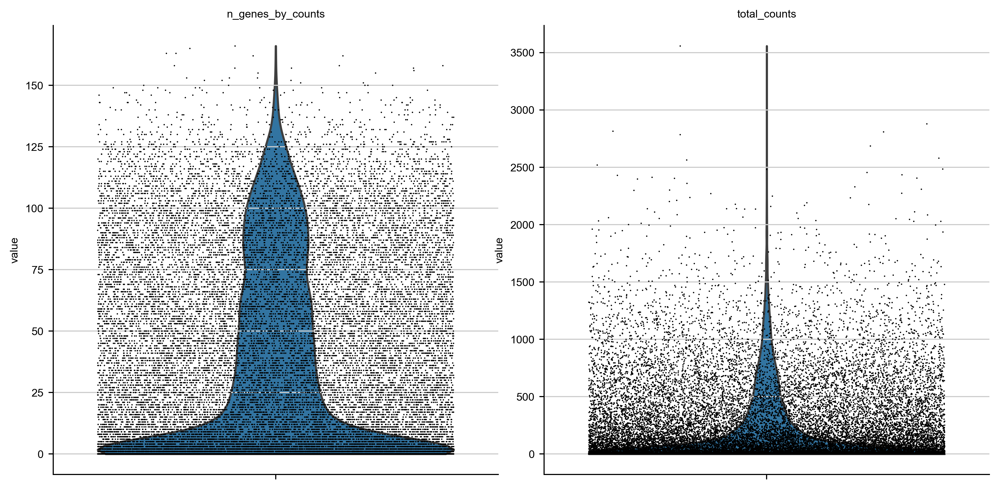

In [18]:
# A violin plot of some of the computed quality measures:
# - the number of genes expressed in the count matrix
# - the total counts per cell
sc.pl.violin(adata, ['n_genes_by_counts', 'total_counts'],
             jitter=0.4, multi_panel=True)

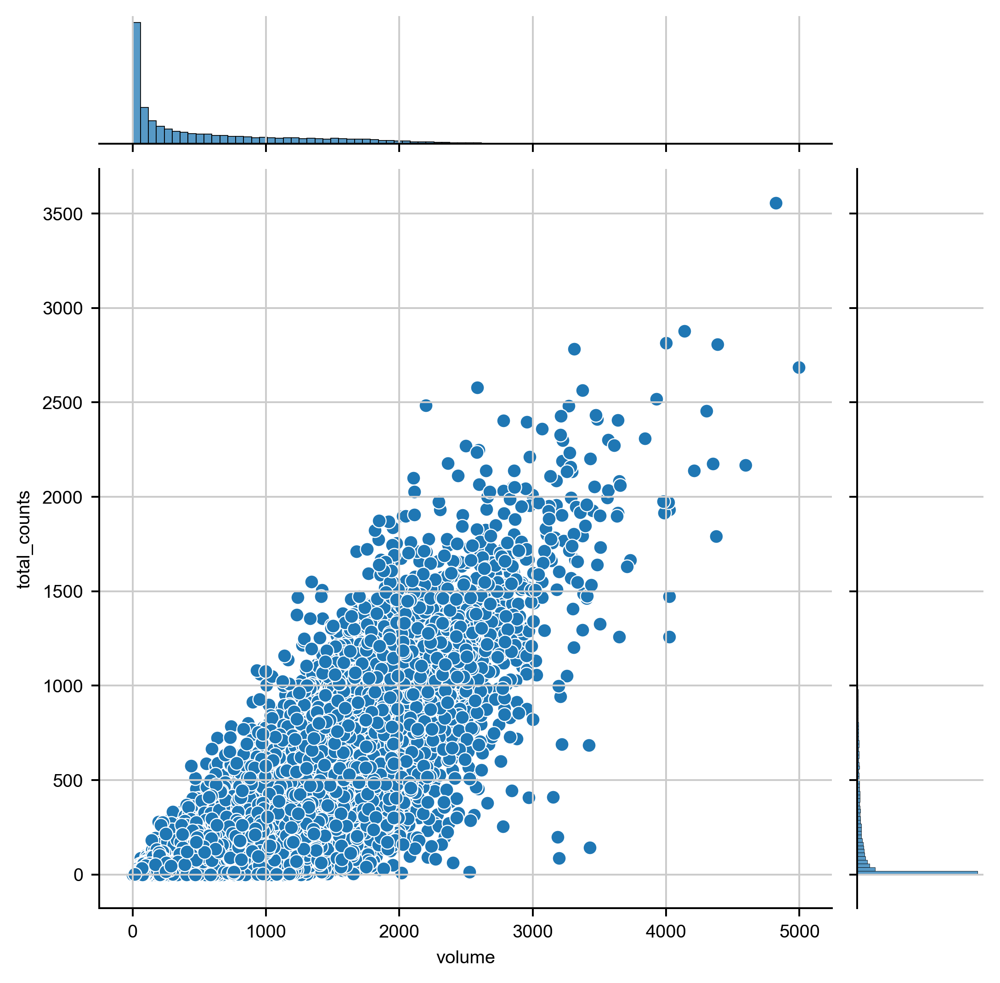

In [19]:
sns.jointplot(data=adata.obs, x='volume', y='total_counts')

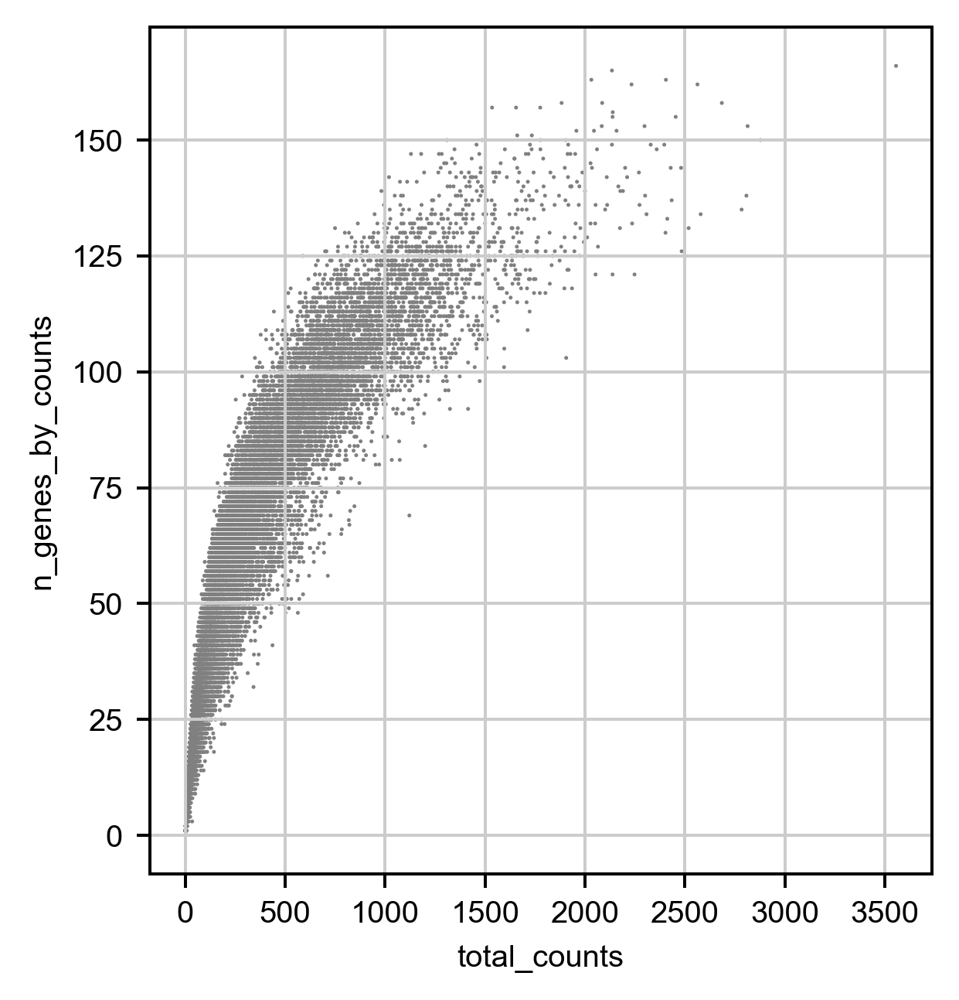

In [20]:
# Plot the distributions of gene counts
sc.pl.scatter(adata, x='total_counts', y='n_genes_by_counts')

In [21]:
adata = adata[adata.obs['total_counts'] > 20]
adata = adata[adata.obs['n_genes_by_counts'] > 10]

print(len(adata))

17503


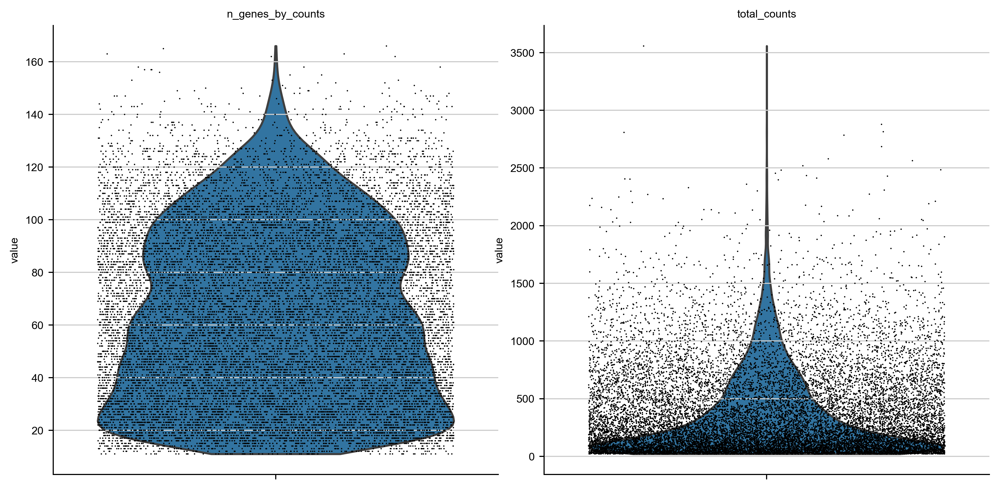

In [22]:
# A violin plot of some of the computed quality measures:
# - the number of genes expressed in the count matrix
# - the total counts per cell
sc.pl.violin(adata, ['n_genes_by_counts', 'total_counts'],
             jitter=0.4, multi_panel=True)

In [23]:
max(adata.obs['total_counts'])

3557.0

## 4. PCA and UMAP of the MERFISH data (for quick test)

E:\Users\puzheng\AppData\anaconda3\envs\merlin_postanalysis\lib\site-packages\scanpy\preprocessing\_normalization.py:155: UserWarning: Revieved a view of an AnnData. Making a copy.
  view_to_actual(adata)


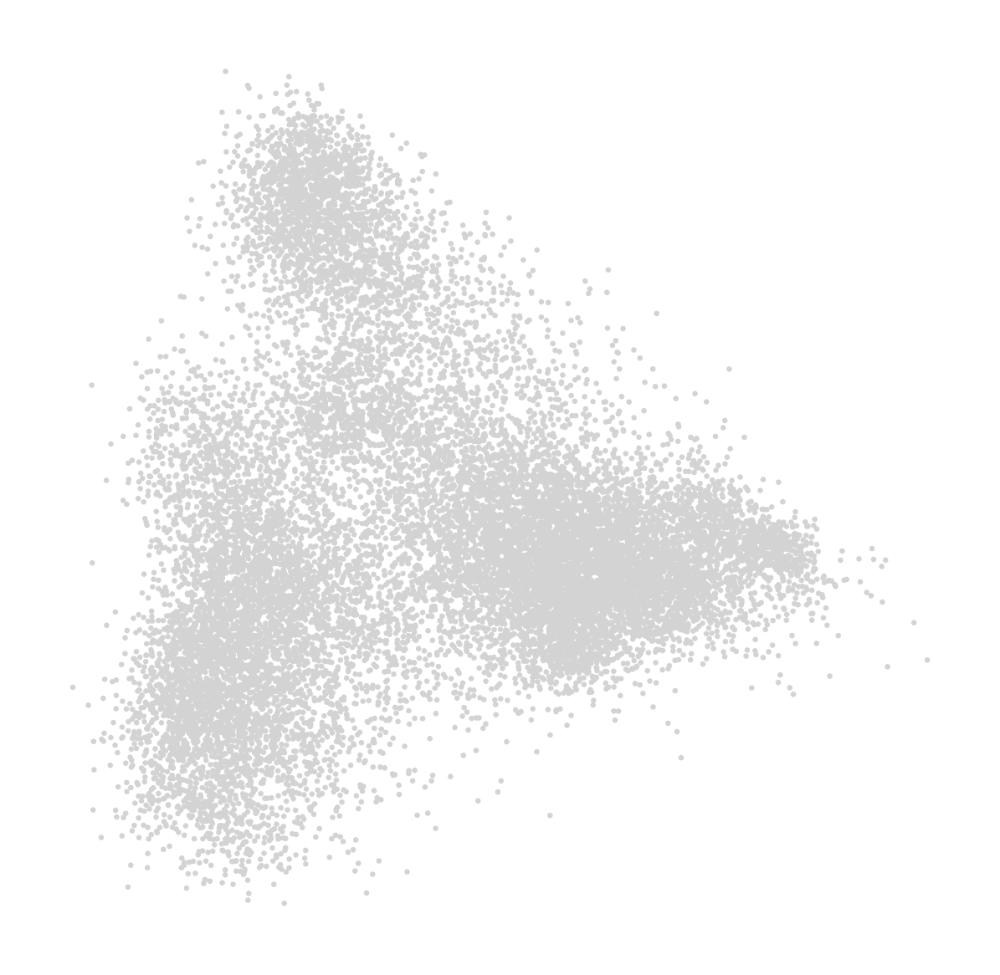

In [24]:
# Total-count normalize (library-size correct) the data matrix to 10,000 reads per cell
sc.pp.normalize_total(adata, target_sum=1e2)
# Logarithmize the data
sc.pp.log1p(adata)
# Regress out total counts
sc.pp.regress_out(adata, 'total_counts')
# Convert gene expressions to Z-scores
sc.pp.scale(adata, max_value=10)
# Principal component analysis
sc.tl.pca(adata, svd_solver='arpack')
# Plot the PCA results
sc.pl.pca(adata)

In [25]:
%%time
# Computing the neighborhood graph
sc.pp.neighbors(adata, n_neighbors=10, n_pcs=50)

Wall time: 22.8 s


In [26]:
%%time
# Clustering
sc.tl.leiden(adata, resolution=1)

Wall time: 2.14 s


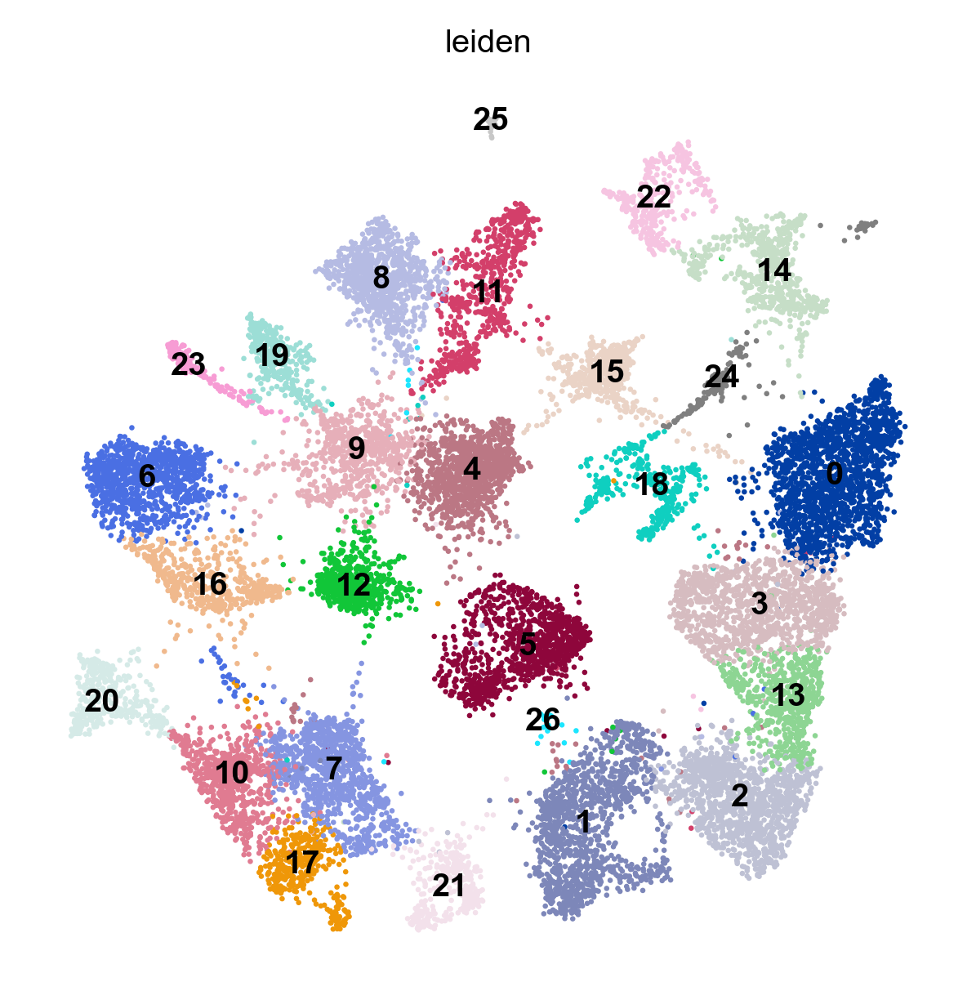

Wall time: 16.5 s


In [27]:
%%time
# Embed with UMAP
sc.tl.umap(adata)
# Plot the UMAP
sc.pl.umap(adata, color='leiden', legend_loc='on data')

(-3689.8586690117604, 5689.7559275672775, -1402.7497787055559, 4234.6562870414)

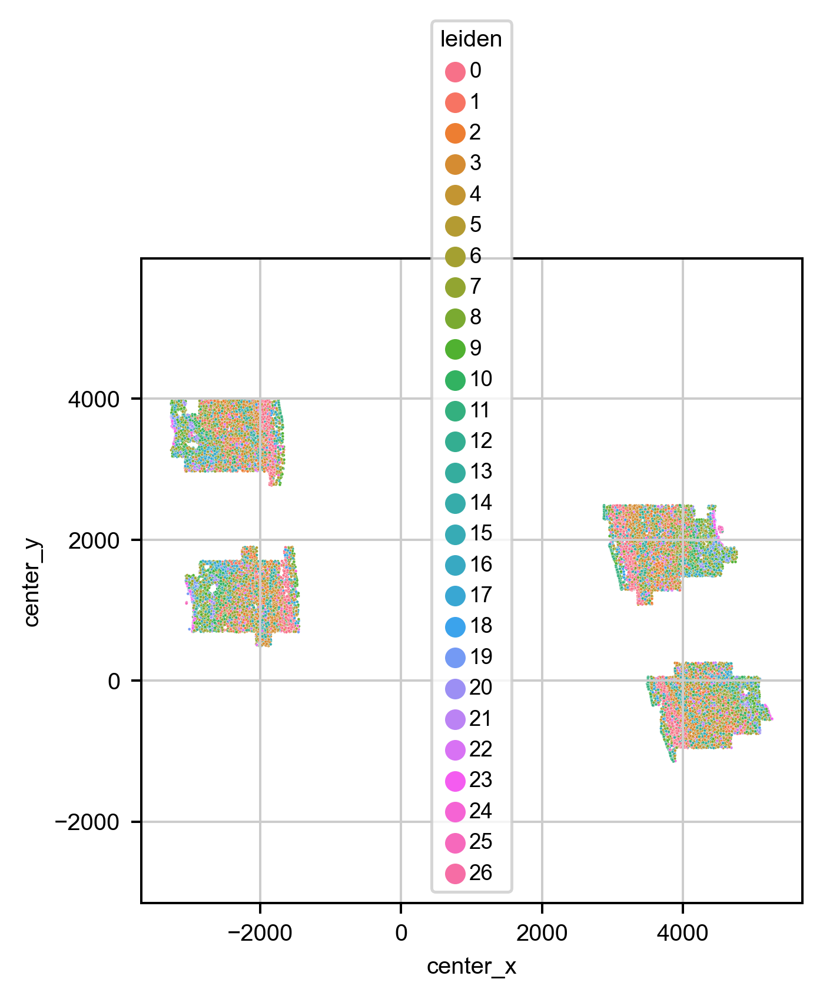

In [29]:
# visualzie the spatial dist for clusters
import matplotlib.pyplot as plt
sns.scatterplot(data=adata.obs, x='center_x', y='center_y', hue='leiden', s=1)
plt.axis('equal')

(-3689.8586690117604, 5689.7559275672775, -1402.7497787055559, 4234.6562870414)

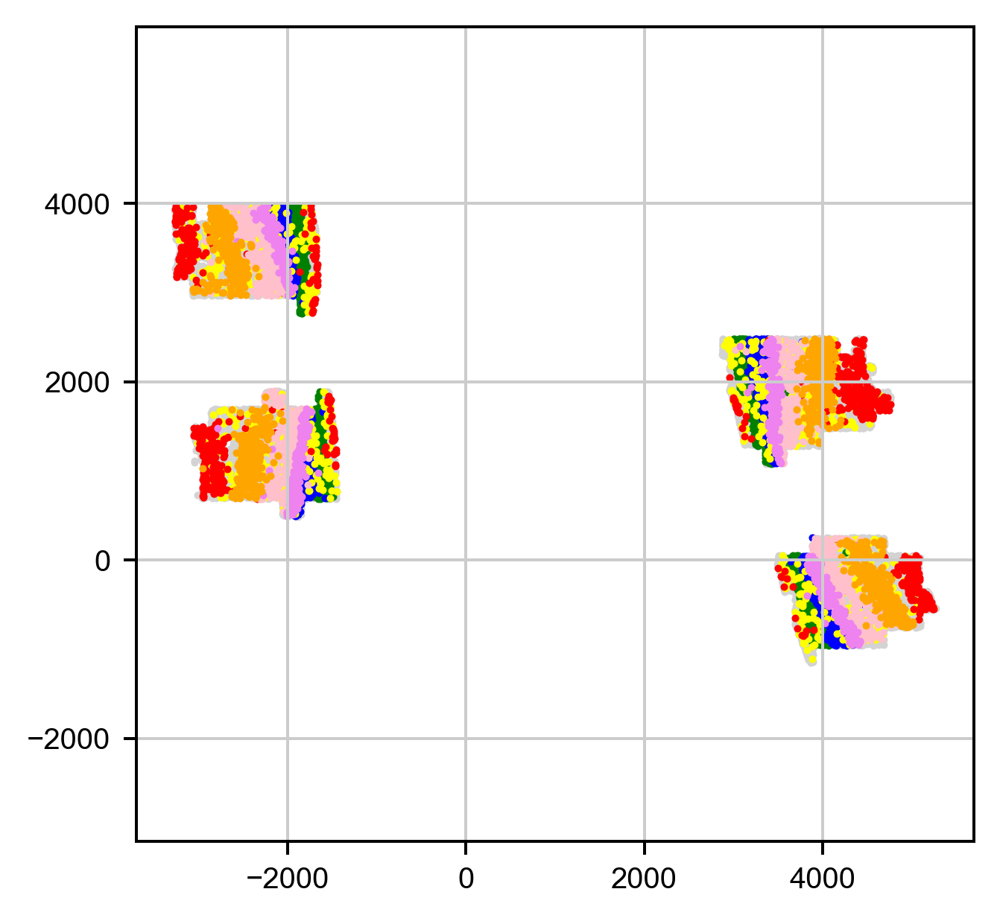

In [30]:
# can also plot a subset of clusters using their "leiden #"
import matplotlib.pyplot as plt

plt.scatter(adata.obs['center_x'], adata.obs['center_y'], c='lightgrey', s=1)


df = adata.obs[adata.obs['leiden'] == '0']
plt.scatter(df['center_x'], df['center_y'], c='green', s=1) 

df = adata.obs[adata.obs['leiden'] == '3']
plt.scatter(df['center_x'], df['center_y'], c='blue', s=1) 

#df = adata.obs[adata.obs['leiden'] == '15']
#plt.scatter(df['center_x'], df['center_y'], c='green', s=1) 


df = adata.obs[adata.obs['leiden'] == '8']
plt.scatter(df['center_x'], df['center_y'], c='yellow', s=1) 


df = adata.obs[adata.obs['leiden'] == '9'] 
plt.scatter(df['center_x'], df['center_y'], c='red', s=1)   


df = adata.obs[adata.obs['leiden'] == '2']
plt.scatter(df['center_x'], df['center_y'], c='pink', s=1) 


df = adata.obs[adata.obs['leiden'] == '13']
plt.scatter(df['center_x'], df['center_y'], c='violet', s=1) 


df = adata.obs[adata.obs['leiden'] == '7']
plt.scatter(df['center_x'], df['center_y'], c='orange', s=1) 


plt.axis('equal')

## 5. Check count for each cell for genes of interest

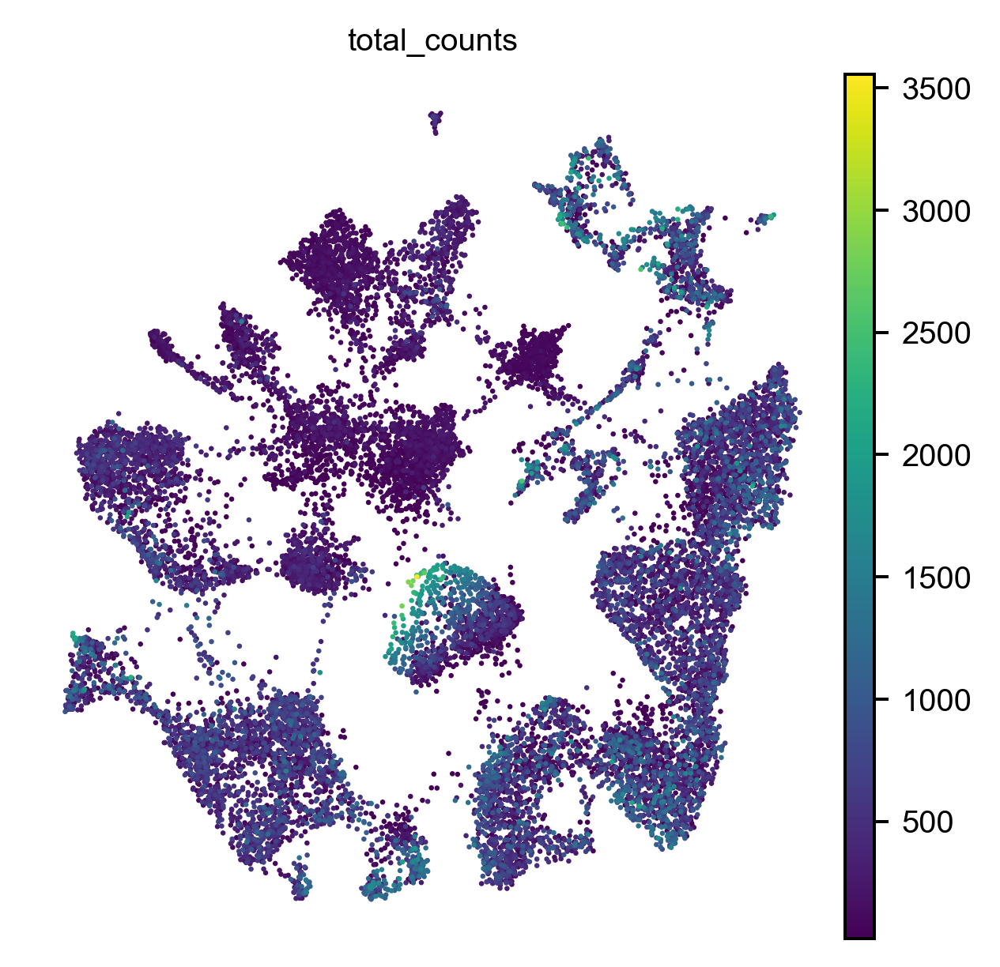

In [31]:
sc.pl.umap(adata, color='total_counts')

In [34]:
marker_genes = [_g for _g in sel_gene_df['Target gene'].values if (_g in adata.var.index)]
print(marker_genes)

['Slc30a3', 'Slc32a1', 'Otof', 'Rspo1', 'Sncg', 'Fam84b', 'Tshz2', 'Syt6', 'Nxph4', 'Cux2', 'Rorb', 'Sulf2', 'Ptpru', 'Car3', 'Aqp4', 'Flt1', 'Igf2', 'Pdgfra', 'Sox10', 'Ctss', 'Vtn', 'Bgn']


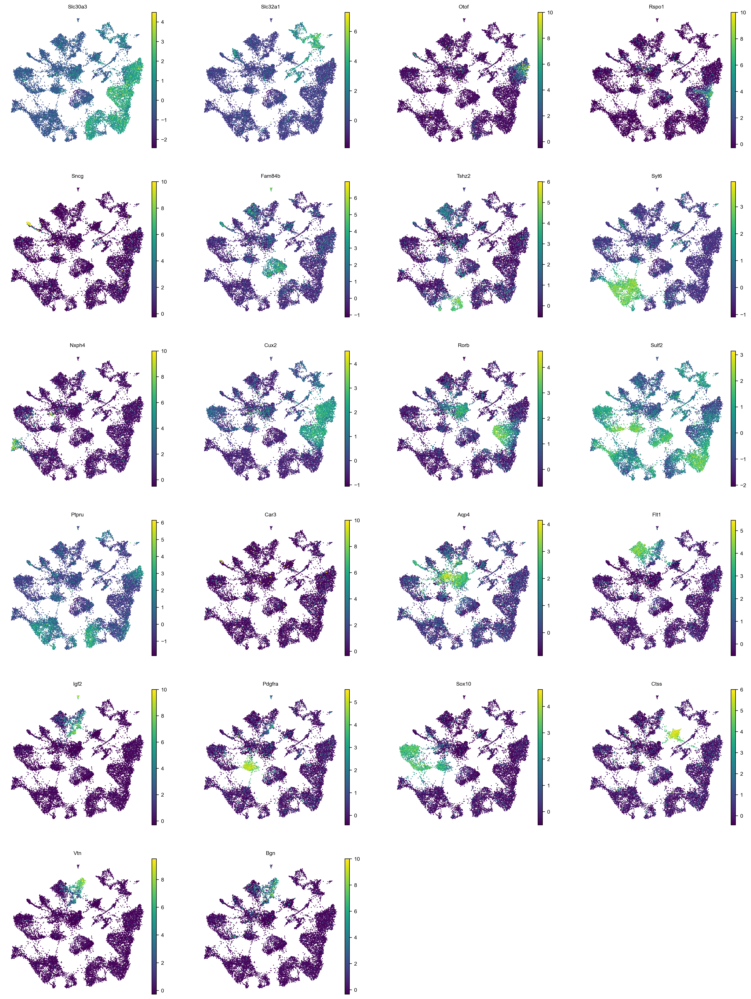

In [35]:
sc.pl.umap(adata, color=marker_genes)

## 6.UMAP can be done using different settings and can be saved into different label column for cell type classifer use later

## 6.1 Use higher expected pcs and resolution to UMAP for cell-type distinction at "cluster" level

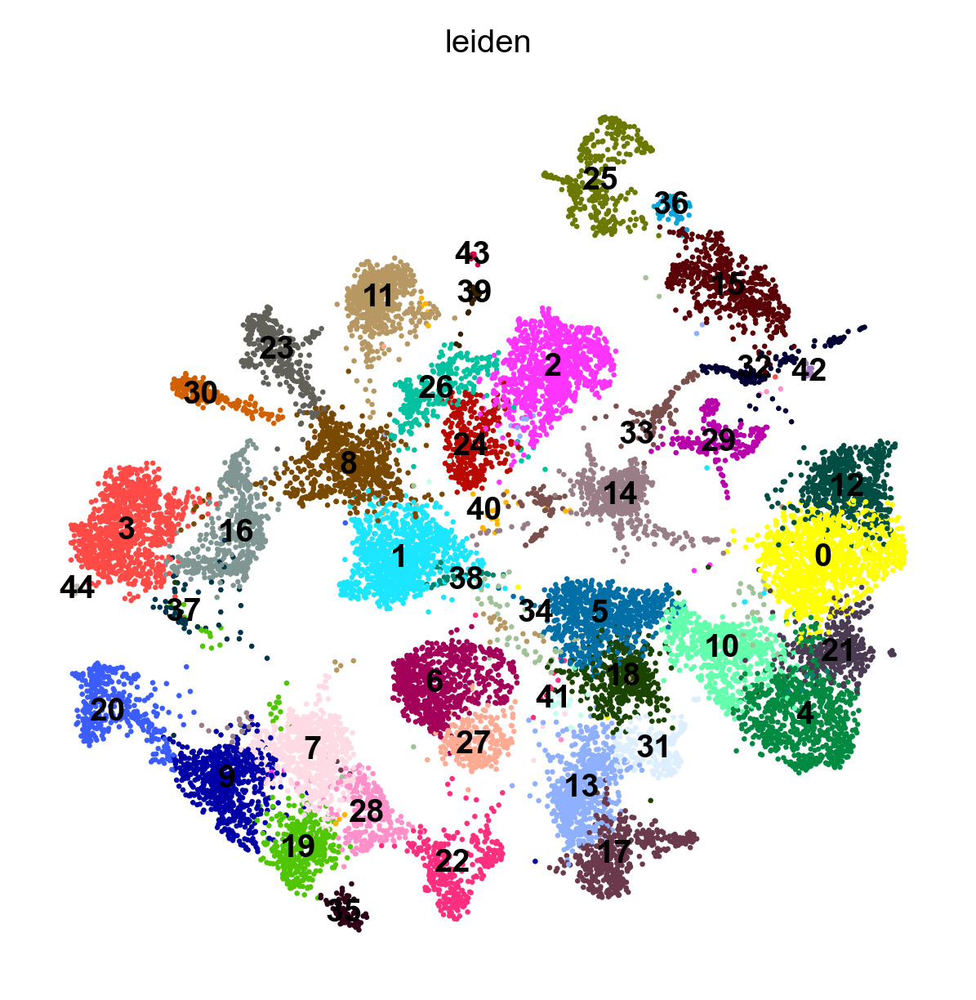

Wall time: 17.3 s


In [39]:
%%time
# Computing the neighborhood graph
sc.pp.neighbors(adata, n_neighbors=5, n_pcs=50)

sc.tl.leiden(adata, resolution=2)

sc.tl.umap(adata)
# Plot the UMAP
sc.pl.umap(adata, color='leiden', legend_loc='on data')

# save this labels as a new column as 'leiden_cluster'
adata.obs['leiden_cluster'] = adata.obs.leiden

## 6.2 Use lower expected pcs and resolution to UMAP for cell-type distinction at subclass level

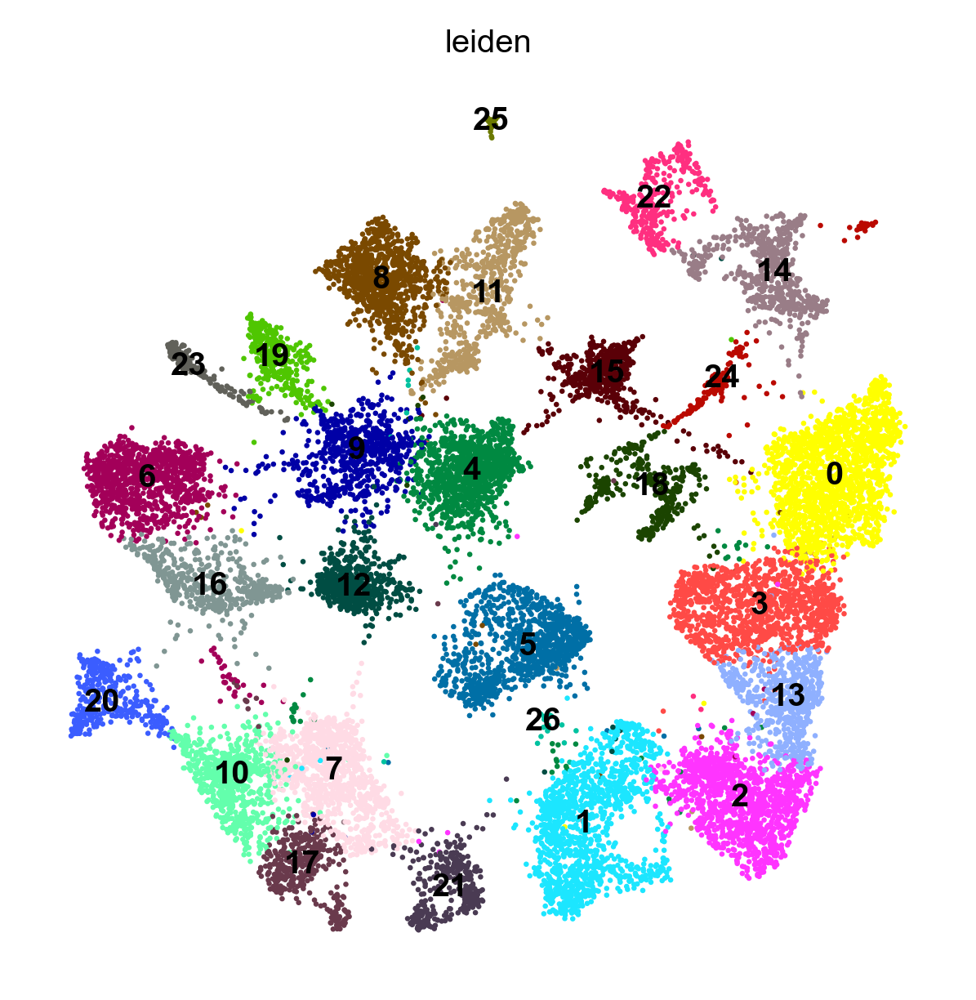

Wall time: 23.5 s


In [37]:
%%time
# Computing the neighborhood graph
sc.pp.neighbors(adata, n_neighbors=10, n_pcs=50)

sc.tl.leiden(adata, resolution=1)

sc.tl.umap(adata)
# Plot the UMAP
sc.pl.umap(adata, color='leiden', legend_loc='on data')

# save this new labels as a new column as 'leiden_subclass'
adata.obs['leiden_subclass'] = adata.obs.leiden

## 7. Save the analyzed MERFISH adata in h5ad for later use (e.g., cell classifer)

In [41]:
save_filename = os.path.join(os.path.join(postanalysis_folder, 'filtered_cluster_data.h5ad'))

overwrite = False

if not os.path.exists(save_filename) or overwrite:
    print(f"save adata into file: {save_filename}")
    adata.write(save_filename)
else:
    print(f"savefile: {save_filename} already exists")

save adata into file: I:\MERFISH_Analysis\20220203-P_brain_M1_nonclear_PostAnalysis\filtered_cluster_data.h5ad
